# **NLP - lab 3**

**Task 1**

Use the corpus from exercise no. 1 or any other Polish corpus of comparable size.

**Task 2**

Make sure the texts in the corpus does not contain HTML code.

In [1]:
path = './Acts'

In [123]:
from bs4 import BeautifulSoup
import os
import numpy as np

def check_html(path: str) -> bool:
  """Functions checks if are there any html codes in texts in path directory"""

  temp_list = []
  for filename in os.listdir(path):

        f = os.path.join(path, filename)

        if os.path.isfile(f):
            with open(f, encoding='utf-8') as file:
                file = file.read()

                temp_list.append(bool(BeautifulSoup(file, "html.parser").find()))
  result = np.sum(temp_list)

  if result == 0:
    return False
  else:
    return True

check_html(path)

False

There are no html codes in the law corpus.

**Task 3**

Use SpaCy tokenizer API to tokenize the text from the cleaned law corpus.

In [124]:
from spacy.tokenizer import Tokenizer
from spacy.lang.pl import Polish
import regex as reg

# Let's define standard tokenizer for Polish language
nlp = Polish()
tokenizer = nlp.tokenizer


def clean_text(line: str) -> str:
  """Function substitutes non-words to whitespace and returns preprocessed text"""
  line = reg.sub(r'[^\w]', ' ', line)
  line = reg.sub(r'\w*\d\w*', '', line)
  line = line.lower()

  return line

def get_tokens(path: str, filename: str) -> list:
  """Function returns tokens of the filename from the path directory"""

  f = os.path.join(path, filename)

  if os.path.isfile(f):
    with open(f, encoding = 'utf-8') as file:
      f = file.read()
      cleaned_text = clean_text(f)
      tokens = tokenizer(cleaned_text)
      tokens = [str(token) for token in tokens if not token.is_punct
                                              and not token.is_digit
                                              and not token.is_space
                                              and not token.like_num
                                              and str(token) != 'r'
                                              and len(str(token)) >= 2]
      return tokens

# We can see that it works fine 
get_tokens(path, '1993_602.txt')

['dz',
 'nr',
 'poz',
 'ustawa',
 'dnia',
 'grudnia',
 'zmianie',
 'niektórych',
 'ustaw',
 'dotyczących',
 'zaopatrzenia',
 'emerytalnego',
 'art',
 'ustawie',
 'dnia',
 'maja',
 'zaopatrzeniu',
 'inwalidów',
 'wojennych',
 'wojskowych',
 'oraz',
 'ich',
 'rodzin',
 'dz',
 'nr',
 'poz',
 'nr',
 'poz',
 'nr',
 'poz',
 'nr',
 'poz',
 'nr',
 'poz',
 'art',
 'wprowadza',
 'się',
 'następujące',
 'zmiany',
 'ust',
 'otrzymuje',
 'brzmienie',
 'podstawę',
 'wymiaru',
 'renty',
 'inwalidzkiej',
 'ustala',
 'się',
 'od',
 'kwoty',
 'stanowiącej',
 'podstawę',
 'waloryzacji',
 'na',
 'podstawie',
 'przepisów',
 'zaopatrzeniu',
 'emerytalnym',
 'pracowników',
 'ich',
 'rodzin',
 'podwyższenie',
 'kwot',
 'podstawy',
 'wymiaru',
 'renty',
 'inwalidzkiej',
 'następuje',
 'od',
 'miesiąca',
 'którym',
 'jest',
 'przeprowadzana',
 'waloryzacja',
 'ust',
 'otrzymuje',
 'brzmienie',
 'ustalenie',
 'wysokości',
 'renty',
 'następuje',
 'przez',
 'pomnożenie',
 'podwyższonej',
 'myśl',
 'ust',
 'podsta

In [125]:
from collections import defaultdict

def create_tokens_dict(path) -> list:
  """Function returns a dictionary of tokens from all files from the path directory"""
  
  result = defaultdict(lambda: [])

  # Iterating over files in the directory
  for filename in os.listdir(path):
      result[filename] = get_tokens(path, filename)

  return result

In [126]:
tokens_dict = create_tokens_dict(path)
tokens_dict['2001_25.txt']

['dz',
 'nr',
 'poz',
 'ustawa',
 'dnia',
 'grudnia',
 'inspekcji',
 'handlowej',
 'rozdział',
 'przepisy',
 'ogólne',
 'art',
 'inspekcja',
 'handlowa',
 'zwana',
 'dalej',
 'inspekcją',
 'jest',
 'organem',
 'kontroli',
 'powołanym',
 'do',
 'ochrony',
 'interesów',
 'praw',
 'konsumentów',
 'oraz',
 'interesów',
 'gospodarczych',
 'państwa',
 'ustawa',
 'reguluje',
 'zadania',
 'organizację',
 'inspekcji',
 'prawa',
 'obowiązki',
 'przedsiębiorców',
 'zasady',
 'postępowania',
 'organów',
 'inspekcji',
 'oraz',
 'prawa',
 'obowiązki',
 'pracowników',
 'inspekcji',
 'do',
 'postępowania',
 'przed',
 'organami',
 'inspekcji',
 'zakresie',
 'nieuregulowanym',
 'ustawą',
 'stosuje',
 'się',
 'przepisy',
 'kodeksu',
 'postępowania',
 'administracyjnego',
 'art',
 'ilekroć',
 'ustawie',
 'jest',
 'mowa',
 'przedsiębiorcy',
 'należy',
 'przez',
 'to',
 'rozumieć',
 'przedsiębiorcę',
 'rozumieniu',
 'przepisów',
 'ustawy',
 'dnia',
 'listopada',
 'prawo',
 'działalności',
 'gospodarczej',
 

**Task 4**

Compute frequency list for each of the processed files.

In [127]:
from collections import Counter

def calculate_freq_list(tokens_dict: dict) -> dict:

  result = defaultdict(lambda: [])
  for filename in tokens_dict.keys():
    result[filename] = Counter(tokens_dict[filename])

  return result

freq_list = calculate_freq_list(tokens_dict)
freq_list

defaultdict(<function __main__.calculate_freq_list.<locals>.<lambda>()>,
            {'2004_867.txt': Counter({'dz': 2,
                      'nr': 15,
                      'poz': 15,
                      'dnia': 5,
                      'marca': 1,
                      'zmianie': 1,
                      'ustawy': 1,
                      'dopłatach': 2,
                      'do': 7,
                      'oprocentowania': 3,
                      'niektórych': 2,
                      'kredytów': 3,
                      'bankowych': 2,
                      'art': 5,
                      'ustawie': 1,
                      'stycznia': 1,
                      'oraz': 1,
                      'po': 1,
                      'dodaje': 1,
                      'się': 1,
                      'brzmieniu': 1,
                      'dopłaty': 1,
                      'zaciągniętych': 1,
                      'od': 2,
                      'lipca': 1,
                      'kwietnia': 

**Task 5**

Aggregate the result to obtain one global frequency list.

In [128]:
def calculate_global_freq_list(freq_list: dict) -> dict:

  result = defaultdict(lambda: 0)

  for file_name in freq_list.keys():
    tokens = freq_list[file_name].keys()
    for token in tokens:
      result[token] += freq_list[file_name][token]

  return result

global_freq_list = calculate_global_freq_list(freq_list)
global_freq_list

defaultdict(<function __main__.calculate_global_freq_list.<locals>.<lambda>()>,
            {'dz': 8888,
             'nr': 44953,
             'poz': 45245,
             'dnia': 17954,
             'marca': 783,
             'zmianie': 1518,
             'ustawy': 13099,
             'dopłatach': 39,
             'do': 60768,
             'oprocentowania': 260,
             'niektórych': 974,
             'kredytów': 611,
             'bankowych': 263,
             'art': 83805,
             'ustawie': 5478,
             'stycznia': 1894,
             'oraz': 33564,
             'po': 13568,
             'dodaje': 8423,
             'się': 45887,
             'brzmieniu': 7295,
             'dopłaty': 212,
             'zaciągniętych': 73,
             'od': 16697,
             'lipca': 1339,
             'kwietnia': 993,
             'przez': 20956,
             'krajowych': 345,
             'przedsiębiorców': 682,
             'prowadzących': 439,
             'produkcję': 105,
   

**Task 6**

Reject all entries that are shorter than 2 characters or contain non-letter characters (make sure to include Polish diacritics).

The task was made in the task 3.

**Task 7**

Make a plot in a logarithmic scale (for X and Y):
1. X-axis should contain the rank of a term, meaning the first rank belongs to the term with the highest number of occurrences; the terms with the same number of occurrences should be ordered by their name.
2. Y-axis should contain the number of occurrences of the term with given rank.

In [129]:
def calculate_rank_terms(freq_list: dict) -> dict:

  temp_dict = {elem[0] : elem[1] for elem in sorted(freq_list.items(), key = lambda x: (-x[1], x[0]))}
  rank_dict = {(a,b):c for c, (a, b) in enumerate(temp_dict.items())}
  return rank_dict

rank_dict = calculate_rank_terms(global_freq_list)
rank_dict

{('art', 83805): 0,
 ('do', 60768): 1,
 ('ust', 53636): 2,
 ('na', 50657): 3,
 ('się', 45887): 4,
 ('lub', 45800): 5,
 ('poz', 45245): 6,
 ('nr', 44953): 7,
 ('oraz', 33564): 8,
 ('mowa', 28783): 9,
 ('nie', 23008): 10,
 ('przez', 20956): 11,
 ('pkt', 19124): 12,
 ('dnia', 17954): 13,
 ('których', 17932): 14,
 ('od', 16697): 15,
 ('po', 13568): 16,
 ('jest', 13197): 17,
 ('ustawy', 13099): 18,
 ('może', 12096): 19,
 ('jeżeli', 12047): 20,
 ('którym', 11789): 21,
 ('za', 11181): 22,
 ('brzmienie', 10576): 23,
 ('spraw', 10025): 24,
 ('otrzymuje', 9835): 25,
 ('dz', 8888): 26,
 ('albo', 8708): 27,
 ('dodaje', 8423): 28,
 ('ich', 8199): 29,
 ('dla', 7937): 30,
 ('pracy', 7633): 31,
 ('minister', 7582): 32,
 ('której', 7476): 33,
 ('brzmieniu', 7295): 34,
 ('drodze', 7179): 35,
 ('podstawie', 6850): 36,
 ('stosuje', 6680): 37,
 ('przypadku', 6494): 38,
 ('niż', 6452): 39,
 ('tym', 6367): 40,
 ('jego', 6320): 41,
 ('są', 6157): 42,
 ('być', 6120): 43,
 ('zakresie', 6098): 44,
 ('właściwy', 

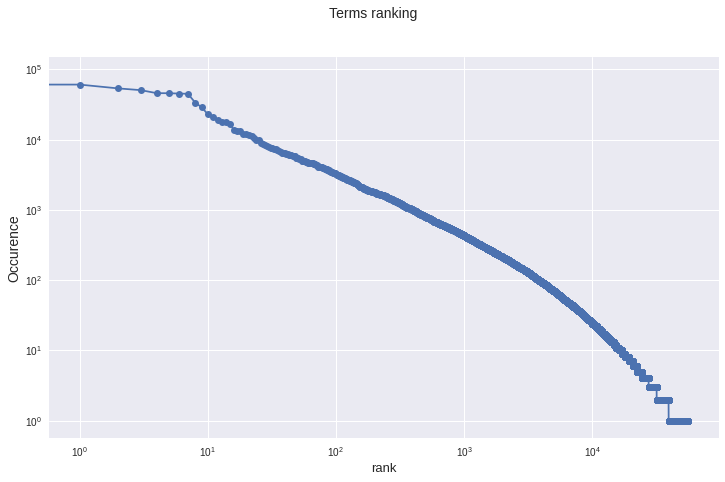

In [130]:
import matplotlib.pyplot as plt

f = plt.figure()
f.set_figwidth(12)
f.set_figheight(7)
plt.style.use('seaborn')

x_vector = list(rank_dict.values())
y_vector = [elem[1] for elem in rank_dict.keys()]

plt.plot(x_vector, y_vector, marker ='o')

plt.suptitle('Terms ranking', fontsize=14)
plt.xlabel('rank', fontsize = 13)
plt.ylabel('Occurence', fontsize = 14)
plt.xscale("log")
plt.yscale('log')
plt.show()

**Task 8**

Install Morfeusz (Binding dla Pythona) and use it to find all words that do not appear in that dictionary.

In [131]:
!pip install morfeusz2

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [132]:
import morfeusz2

def find_unknown_words(freq_list: dict) -> list:

  morf = morfeusz2.Morfeusz(aggl="isolated")
  temp_dict = {elem[0] : elem[1] for elem in sorted(freq_list.items(), key = lambda x: (-x[1], x[0]))}
  result = []

  for (word, count) in temp_dict.items():
    _, _, (_, _, tag, _, _) = morf.analyse(word)[0]
    if tag == "ign":
      result.append((word, count))

  return result

words_unknown = find_unknown_words(global_freq_list)
words_unknown = sorted(words_unknown, key=lambda item: item[1], reverse=True)

**Task 9**

Find 30 words with the highest ranks that do not belong to the dictionary.

In [133]:
words_unknown_task_9 = words_unknown[:30]
words_unknown_task_9

[('późn', 1066),
 ('gmo', 298),
 ('sww', 227),
 ('skw', 196),
 ('ex', 169),
 ('ike', 162),
 ('remediacji', 120),
 ('ure', 103),
 ('uke', 97),
 ('kn', 95),
 ('cn', 83),
 ('pkwiu', 81),
 ('udt', 77),
 ('bswsg', 70),
 ('bswp', 66),
 ('biobójczych', 63),
 ('phs', 53),
 ('hcfc', 46),
 ('fep', 42),
 ('mgo', 41),
 ('utk', 40),
 ('frd', 36),
 ('ron', 35),
 ('uokik', 35),
 ('cbśp', 34),
 ('doke', 34),
 ('haccp', 32),
 ('pcn', 32),
 ('vitro', 32),
 ('iia', 31)]

**Task 10**

Find 30 random words (i.e. shuffle the words) with 5 occurrences that do not belong to the dictionary.

In [134]:
words_unknown_task_10 = [(word, count) for word, count in words_unknown if count == 5][:30]
words_unknown_task_10

[('agave', 5),
 ('ami', 5),
 ('betezda', 5),
 ('bowego', 5),
 ('cego', 5),
 ('chelatującym', 5),
 ('cji', 5),
 ('contagious', 5),
 ('cyjne', 5),
 ('cza', 5),
 ('cznika', 5),
 ('czonych', 5),
 ('czonym', 5),
 ('członkow', 5),
 ('denitracyjne', 5),
 ('difenylopropylo', 5),
 ('dowej', 5),
 ('dowych', 5),
 ('dzialności', 5),
 ('eudravigilance', 5),
 ('heptanol', 5),
 ('inci', 5),
 ('instrumen', 5),
 ('jwh', 5),
 ('kj', 5),
 ('kow', 5),
 ('kowskich', 5),
 ('kowskiego', 5),
 ('kpwig', 5),
 ('metylofenetyloamina', 5)]

**Task 11**

Use Levenshtein distance and the frequency list, to determine the most probable correction of the words from lists defined in points 8 and 9. (Note: You don't have to apply the distance directly. Any method that is more efficient than scanning the dictionary will be appreciated.)

In [135]:
!pip install levenshtein

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [136]:
from Levenshtein import distance
from collections import defaultdict

words_unknown_ = [elem[0] for elem in words_unknown]
word_list = [word for word in list(global_freq_list.keys()) if word not in words_unknown_]

def determine_word_correction(word: str, word_list: list = word_list) -> list:

  temp_dict = defaultdict(lambda: 0)
  
  for freq_word in word_list:
    temp_dict[freq_word] = distance(word, freq_word)

  temp_dict = sorted(temp_dict.items(), key=lambda x:x[1])
  temp_dict = { k:v for (k,v) in temp_dict} 

  min_value = min(temp_dict.values())
  result = [k for k, v in temp_dict.items() if v == min_value]

  return result

In [137]:
def find_corrections(words_to_correct: list) -> dict:

  result = defaultdict(lambda: [])

  for word in words_to_correct:
    result[word] = determine_word_correction(word)

  return result

In [165]:
words_unknown_task_9_ = [elem[0] for elem in words_unknown_task_9]

corrections_task_9 = find_corrections(words_unknown_task_9_)

for key in corrections_task_9.keys():
  print(f'Word: {key}, corrections: {corrections_task_9[key]}')

Word: późn, corrections: ['plan', 'pół', 'pól', 'pln', 'pn', 'pan', 'paź', 'płyn']
Word: gmo, corrections: ['go', 'mo', 'imo', 'gm']
Word: sww, corrections: ['sów', 'swe', 'swą', 'sw', 'ww']
Word: skw, corrections: ['sów', 'kw', 'sw']
Word: ex, corrections: ['ix', 'em', 'ej', 'en', 'xx', 'et', 'es', 'ef']
Word: ike, corrections: ['ile', 'ie']
Word: remediacji, corrections: ['mediacji']
Word: ure, corrections: ['urz', 'ue', 're']
Word: uke, corrections: ['ue']
Word: kn, corrections: ['on', 'in', 'ki', 'kw', 'ku', 'kg', 'km', 'kin', 'ka', 'mn', 'ko', 'pn', 'en', 'kan']
Word: cn, corrections: ['co', 'on', 'cen', 'cz', 'in', 'ci', 'ce', 'cm', 'cl', 'ch', 'ca', 'mn', 'pn', 'en']
Word: pkwiu, corrections: ['kwitu', 'piwie', 'powie']
Word: udt, corrections: ['ust', 'ddt', 'udo']
Word: bswsg, corrections: ['bieg', 'usług', 'swej', 'ksiąg', 'wsi', 'swego', 'swe', 'swój', 'uwag', 'ewg', 'wg', 'wag', 'swym', 'brzeg', 'swą', 'bse', 'bóg', 'bursy', 'asyst', 'sg', 'susz', 'burs', 'sw', 'wsk', 'brwi'

In [166]:
words_unknown_task_10_ = [elem[0] for elem in words_unknown_task_10]

corrections_task_10 = find_corrections(words_unknown_task_10_)

for key in corrections_task_10.keys():
  print(f'Word: {key}, corrections: {corrections_task_10[key]}')

Word: agave, corrections: ['agape']
Word: ami, corrections: ['ani', 'wami', 'mi', 'sami', 'amid', 'asi', 'am', 'mami']
Word: betezda, corrections: ['metoda', 'beta', 'betel', 'butelka']
Word: bowego, corrections: ['nowego']
Word: cego, corrections: ['tego', 'jego', 'nego', 'wego', 'czego', 'ego', 'celo', 'rego', 'mego']
Word: chelatującym, corrections: ['reklamującym', 'ratującym', 'uchylającym', 'emitującym', 'kredytującym', 'chorującym']
Word: cji, corrections: ['ci']
Word: contagious, corrections: ['kontami', 'postawione', 'kontaktu', 'montażowe', 'montażu', 'notariusz', 'postawiono', 'postawiony', 'kontaktowy', 'kontaktowe', 'montażową', 'postawiona', 'rotawirusy', 'montanowy']
Word: cyjne, corrections: ['celne', 'akcyjne', 'tajne', 'cynk', 'czynne', 'rybne', 'mylne', 'czyje', 'cyny', 'żyje', 'cenne', 'myjni', 'myjnie']
Word: cza, corrections: ['za', 'czas', 'czy', 'cz', 'cła', 'ca', 'cia', 'cba', 'sza', 'cha']
Word: cznika, corrections: ['ocznika', 'znika']
Word: czonych, correcti

**Task 12**

Load SGJP dictionary (Słownik SGJP dane tekstowe) to ElasticSearch (one document for each form) and use fuzzy matching to obtain the possible corrections of the 30 words with 5 occurrences that do not belong to the dictionary.

In [140]:
import gzip
import shutil

with gzip.open('./SGJP/sgjp-20221030.tab.gz', 'rb') as f_in:
    with open('./SGJP/sgjp-20221030.tab', 'wb') as f_out:
        shutil.copyfileobj(f_in, f_out)

**ElasticSearch setup**

In [141]:
!pip install elasticsearch==7.10.0
!pip install elasticsearch_dsl

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
%%bash

wget -q https://artifacts.elastic.co/downloads/elasticsearch/elasticsearch-7.10.0-linux-x86_64.tar.gz
wget -q https://artifacts.elastic.co/downloads/elasticsearch/elasticsearch-7.10.0-linux-x86_64.tar.gz.sha512
tar -xzf elasticsearch-7.10.0-linux-x86_64.tar.gz
sudo chown -R daemon:daemon elasticsearch-7.10.0/
shasum -a 512 -c elasticsearch-7.10.0-linux-x86_64.tar.gz.sha512

elasticsearch-7.10.0-linux-x86_64.tar.gz: OK


In [ ]:
%%bash

sudo elasticsearch-7.10.0/bin/elasticsearch-plugin install pl.allegro.tech.elasticsearch.plugin:elasticsearch-analysis-morfologik:7.10.0

-> Installing pl.allegro.tech.elasticsearch.plugin:elasticsearch-analysis-morfologik:7.10.0
-> Downloading pl.allegro.tech.elasticsearch.plugin:elasticsearch-analysis-morfologik:7.10.0 from maven central
[=================================================] 100%   
-> Installed analysis-morfologik


In [142]:
%%bash --bg

sudo -H -u daemon elasticsearch-7.10.0/bin/elasticsearch

In [145]:
%%bash

curl -sX GET "localhost:9200/"

{
  "name" : "8765a89392ab",
  "cluster_name" : "elasticsearch",
  "cluster_uuid" : "sOaoX4U2RhqbfUIzsRjo7A",
  "version" : {
    "number" : "7.10.0",
    "build_flavor" : "default",
    "build_type" : "tar",
    "build_hash" : "51e9d6f22758d0374a0f3f5c6e8f3a7997850f96",
    "build_date" : "2020-11-09T21:30:33.964949Z",
    "build_snapshot" : false,
    "lucene_version" : "8.7.0",
    "minimum_wire_compatibility_version" : "6.8.0",
    "minimum_index_compatibility_version" : "6.0.0-beta1"
  },
  "tagline" : "You Know, for Search"
}


In [146]:
import elasticsearch
import elasticsearch_dsl

es = elasticsearch.Elasticsearch()
elasticsearch_dsl.connections.add_connection('python_client', es)

In [147]:
# Let's define the analyzer
analyzer = elasticsearch_dsl.analyzer(
    'keyword_analyzer',
    type='custom',
    tokenizer='keyword'
)

In [148]:
# Wrapper class
class Words(elasticsearch_dsl.Document):
    content = elasticsearch_dsl.Text(
        analyzer=analyzer
    )
    
    class Index:
        name = 'sgjp_words'

In [149]:
from pathlib import Path

lines = Path('./SGJP/sgjp-20221030.tab').read_text(encoding="utf8").split("\n")[:-1]

In [150]:
#Initializatioon
index_name = 'sgjp_words'

# Initialization
if Words._index.exists(using=es):
  Words._index.delete(using=es)

Words.init(using=es)

Now we have to deal with SGJP data format.

In [151]:
def parse_lines(index_name, text):

    for i, line in enumerate(text):
      try:
        word = line.split("\t")[0]
        doc = {
            '_index': index_name,
            '_id': i,
            'content': word
        }
        yield doc
      except:
        continue

In [152]:
from elasticsearch.helpers import parallel_bulk
import tqdm

progress = tqdm.tqdm(desc="Indexing SGJP words", total=len(lines))

for _, _ in parallel_bulk(client=es, actions=parse_lines(index_name, lines)):
    progress.update(1)

Indexing SGJP words: 100%|█████████▉| 7409652/7412295 [12:16<00:00, 14554.61it/s]

**Task 13**

Compare the results of your algorithm and output of ES.

Take a look at the list defined in the task 9.

In [157]:
import requests

es_url = "http://localhost:9200"

for word, count in words_unknown_task_9:
    response = requests.get(
        url=f"{es_url}/{index_name}/_search",
        json={
            "query": {
                "match": {
                    "content": {
                        "query": word,
                        "fuzziness": 2
                    }
                }
            }
        }
    ).json()
    corrected = [hit["_source"]["content"] for hit in response["hits"]["hits"]]
    corrected = ", ".join(corrected)
    print(f"Word: {word}, corrections: {corrected}")

Word: późn, corrections: późni, późno, późna, późna, późne, późne, późne, późne, późni, późno
Word: gmo, corrections: dmo, emo, emo, emo, emo, emo, emo, emo, emo, emo
Word: sww, corrections: siw, sów, suw, swa, swe, swe, swe, swe, swą, swą
Word: skw, corrections: sakw, siw, ska, ski, sków, sów, suw, kw, Liw, Liw
Word: ex, corrections: Rex, ee, ef, ef, el, em, en, eł, eń, eś
Word: ike, corrections: Nike, ikr, iks, iks, iks, ile, ile, ile, kie, kie
Word: remediacji, corrections: repudiacji, repudiacji, repudiacji, remediach, remediami, mediacji, mediacji, mediacji
Word: ure, corrections: Sure, bure, bure, bure, bure, Bure, Bure, użre, uje, ule
Word: uke, corrections: uje, ule, Ale, Ale, Ale, Bek, Bek, Buje, Buje, Buk
Word: kn, corrections: en, in, kb, ka, ki, ki, ki, ką, ką, kin
Word: cn, corrections: ce, cen, ck, ck, ck, ck, ck, ck, ck, ck
Word: pkwiu, corrections: pawiu, pawiu, pawiu, pawiu, Skwir, Akwil, Akwilu, Akwin, Akwinu, kwiku
Word: udt, corrections: udu, udy, uda, uda, uda, udo

Take a look at the list defined in the task 10.

In [158]:
for word, count in words_unknown_task_10:
    response = requests.get(
        url=f"{es_url}/{index_name}/_search",
        json={
            "query": {
                "match": {
                    "content": {
                        "query": word,
                        "fuzziness": 2
                    }
                }
            }
        }
    ).json()
    corrected = [hit["_source"]["content"] for hit in response["hits"]["hits"]]
    corrected = ", ".join(corrected)
    print(f"Word: {word}, corrections: {corrected}")

Word: agave, corrections: agape, Magaje, Sagale, Sagale, abace, agach, agami, agach, agami, agama
Word: ami, corrections: agi, agi, agi, agi, amf, amia, amie, amii, amii, amii
Word: betezda, corrections: etezja
Word: bowego, corrections: Nowego, bosego, bosego, bożego, bożego, nowego, nowego, Nowego, bzowego, bzowego
Word: cego, corrections: Mego, Mego, Rego, Rego, cegło, celo, cero, cewo, cezo, lego
Word: chelatującym, corrections: nielatującym, nielatującym, nielatującym, nielatującym, chatującym, chatującym
Word: cji, corrections: chi, chi, cli, cni, cni, ci, ci, ci, Lucji, Lucji
Word: contagious, corrections: 
Word: cyjne, corrections: bujne, bujne, bujne, bujne, cenne, cenne, cenne, cenne, chybne, cwane
Word: cza, corrections: ceza, cha, czad, czai, czaj, czaj, czak, czan, czap, czar
Word: cznika, corrections: cynika, ocznika, cznia, znika, Monika, Monika, Munika, Ochnika, Ognika, Renika
Word: czonych, corrections: clonych, clonych, uczonych, uczonych, uczonych, uczonych, uczonych

**Task 14**

Draw conclusions regarding:
1. The distribution of words in the corpus.

  If we take a look at the *temp_dict*, then we can see that the most numerous words are redactional units.

2. The number of true misspellings vs. the number of unknown words.

  Among the 30 most popular words outside the dictionary are mostly words that look like abbreviations for certain organizations, such as *cbśp* or *uokik*. In their case, verbal correction makes little sense. We can also notice words such as *iia*, which can mean "second article," treating "ii" as the Roman "two" number. Some words look like misspelings, for example *późn* can denote "późno" or  *instrumen* should be probably *instrument*.

3. The performance of your method compared to ElasticSearch. 

  Because of ElasticSearch's indexing of the data, this method took slightly less time. My method took about 4s, while the method from ElasticSearch took about 1s.

4. The results provided by your method compared to ElasticSearch + the validity of the obtained corrections.

  ElasticSearch was much more accurate than my method. This is because ElasticSearch uses the PJN dictionary and I only used a select portion of words from PJN. As a result, there are smaller or larger deviations, for example:

  - The corrections of *remediacji* in ElasticSearch are *repudiacji*, *remediami*, *mediacji* and only *mediacji* appears in my method.
  - The corrections of *dzialności* in ElasticSearch are: *dzielności*, *dzielności*, *dzielności*, *dzielności*, *dzielności*, *dzietności*, *dzietności*, *dzietności*, *dzietności*, *dzietności*. In my method only *dzielności*. In my opinion both methods have failed, because probably "działalności" could be correct.